<a href="https://colab.research.google.com/github/sxu0/TES_ozone/blob/main/TES_ozone_updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q geopandas  # -q flag suppresses output

     |████████████████████████████████| 1.0 MB 5.2 MB/s 
     |████████████████████████████████| 16.7 MB 32.5 MB/s 
     |████████████████████████████████| 6.3 MB 43.1 MB/s 


In [2]:
from pathlib import Path
import datetime as dt

import numpy as np
import scipy
import pandas as pd
import geopandas as gpd
import netCDF4 as nc
from dateutil.relativedelta import relativedelta

%load_ext google.colab.data_table

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib import rc
rc('animation', html='jshtml')

from scipy.interpolate import CubicSpline

## Load Data

- choose `mon_o3_all.nc` dataset: it's the "normal" product

In [3]:
drive_root = (
    Path.cwd() /
    "drive" /
    "Othercomputers" /
    "My Laptop" /
    "EngSci_Winter_2022" /
    "PHY408" /
    "Final Project"
)
data_paths = {}
data_paths["inc"] = drive_root / "mon_o3_inc_all.nc"
data_paths["spr"] = drive_root / "mon_o3_spr_all.nc"
data_paths["reg"] = drive_root / "mon_o3_all.nc"

Data Dimensions/Indices:
* `lev`: pressure level (27 total)
* `lat`: latitude (deg)
* `lon`: longitude (deg)
* `time`: month (1 through 156 (since 2005-01-01 01:00), spanning 13 years)

<img src="https://drive.google.com/uc?export=view&id=1rf3LNlQp94KBtZoFPVFnzYseM-1cZJCW" width=800\>


In [4]:
file = nc.Dataset(data_paths["reg"])

lon = np.array(file.variables["lon"])
lat = np.array(file.variables["lat"])
lev = np.array(file.variables["lev"])
time = np.array(file.variables["time"])
o3_data = np.array(file.variables["o3"])

## Get Metadata

In [5]:
print(file)

print("\n==== time ====")
print(file.variables["time"])
# print(time)

print("\n==== lat ====")
print(file.variables["lat"])
# print(lat)

print("\n==== lon ====")
print(file.variables["lon"])
# print(lon[0], lon[-1])

print("\n==== lev ====")
print(file.variables["lev"])
print(lev)

print("\n==== O3 data ====")
print(file.variables["o3"])

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    dimensions(sizes): lon(320), lat(160), lev(27), time(156)
    variables(dimensions): float64 lon(lon), float64 lat(lat), float64 lev(lev), float64 time(time), float32 o3(time, lev, lat, lon)
    groups: 

==== time ====
<class 'netCDF4._netCDF4.Variable'>
float64 time(time)
    long_name: Time
    units: months since 2005-01-01 01:00
unlimited dimensions: 
current shape = (156,)
filling on, default _FillValue of 9.969209968386869e+36 used

==== lat ====
<class 'netCDF4._netCDF4.Variable'>
float64 lat(lat)
    units: degrees_north
    long_name: Latitude
unlimited dimensions: 
current shape = (160,)
filling on, default _FillValue of 9.969209968386869e+36 used

==== lon ====
<class 'netCDF4._netCDF4.Variable'>
float64 lon(lon)
    units: degrees_east
    long_name: Longitude
unlimited dimensions: 
current shape = (320,)
filling on, default _FillValue of 9.969209968386869e+36 used

==== le

## Create `datetime` Objects for Month Axis

- use integers (0-155) in analysis & datetime objects in plots

In [10]:
## datetime objects, incrementing by month from 2005-01-01 01:00
time_dt = np.full(len(time), dt.datetime(year=2005, month=1, day=1, hour=1))
for i in range(len(time)):
    time_dt[i] += relativedelta(months=time[i])

## Convert Longitude to Span [-180, 180)

- instead of [0, 360) deg E
- easier to overlay on world map

In [11]:
lon -= 180
o3_data = np.roll(o3_data, 160, axis=3)

# Convert Pressure Levels to Altitude Levels

- throughout the troposphere, altitude can be approximated as a function of pressure as such:
$$h=44.3076934\left(1-\left(\frac{p}{101325}\right)^{0.190284}\right)$$
where $h$ is in km and $p$ is in hPa
- sources: [[1](https://en.wikipedia.org/wiki/Atmospheric_pressure)] [[2](https://en.wikipedia.org/wiki/Barometric_formula)] [[3](https://www.weather.gov/media/epz/wxcalc/pressureAltitude.pdf)]

- recall 23/27 levels are within the troposphere

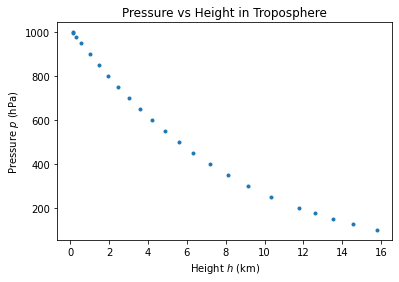

In [157]:
def height_from_pressure(p_hPa):
    """Returns altitude in km given pressure in hPa.
    """
    h_km = 44.3076934 * (1 - (p_hPa / 1013.25) ** 0.190284)

    return h_km

alt_trop = height_from_pressure(lev[:23])

plt.figure(figsize=(6, 4))
plt.plot(alt_trop, lev[:23], '.')
plt.xlabel("Height $h$ (km)")
plt.ylabel("Pressure $p$ (hPa)")
plt.title("Pressure vs Height in Troposphere")
# plt.savefig("pressure_vs_height_troposphere.png")

# Tropospheric Column-Averaged O$_3$

- integrated over just the troposphere (first 23 levels, corresponding to 1000-100 hPa)

- then normalized over height of tropopause (10 km)

In [198]:
column_o3 = np.trapz(o3_data[:, :23, :, :], alt_trop, axis=1) / 16

## broadcast lat & lon
lon_bc = np.tile(lon, lat.size)
lat_bc = np.repeat(lat, lon.size)

In [202]:
%matplotlib auto

world_map = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
fig, ax = plt.subplots(figsize=(12, 6))
world_map.plot(color="lightgrey", ax=ax)
map = plt.scatter(
    lon_bc, lat_bc, s=0, c=np.empty_like(lon_bc),
    alpha=0.6, vmin=0, vmax=400, cmap='autumn'
)

cb = plt.colorbar()
cb.set_label("Column-averaged ozone concentration (ppb)", labelpad=9)
plt.xlabel("Longitude (deg E)")
plt.ylabel("Latitude (deg N)")

Using matplotlib backend: agg


Text(75.875, 0.5, 'Latitude (deg N)')

In [203]:
%matplotlib inline

def init():
    ax.set_xlim(-180, 180)
    ax.set_ylim(-90, 90)
    return map,

## `frame` is month index, corresponding to `frames` argument in FuncAnimation

def update(frame):
    col_o3_of_interest = column_o3[frame, :, :].flatten()
    ## remove fill values
    fill_ind = []
    for i in range(len(col_o3_of_interest)):
        if col_o3_of_interest[i] < 0:
            fill_ind.append(i)
    col_o3_of_interest = np.delete(col_o3_of_interest, fill_ind)
    map.set_offsets(
        np.stack((np.delete(lon_bc, fill_ind), np.delete(lat_bc, fill_ind)), axis=-1)
    )
    map.set_array(col_o3_of_interest)
    map.set_sizes(np.full_like(col_o3_of_interest, 0.9))
    ax.set_title(
        "column-averaged ozone in " + str(time_dt[frame])[:7]
        + "\nmin: " + str(round(min(col_o3_of_interest), 1))
        + "    max: " + str(round(max(col_o3_of_interest), 1))
    )
    return map,

In [204]:
anim = FuncAnimation(fig, update, frames=156, init_func=init, blit=True)
anim

Animation size has reached 21065415 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [205]:
## save animation to mp4
mp4_name = r"tropo_col_avg_ozone.mp4"
writervideo = FFMpegWriter(fps=3)
anim.save(mp4_name, writer=writervideo)

# Time- & Column-Averaged O$_3$ by Latitude



In [206]:
## average over time

# print(column_o3.shape)
# print(np.unique(column_o3))

## filter out filler values
col_o3_weights = np.ones_like(column_o3)
for i in range(column_o3.shape[0]):
    for j in range(column_o3.shape[1]):
        for k in range(column_o3.shape[2]):
            if column_o3[i, j, k] < 0:
                col_o3_weights[i, j, k] = 0

for j in range(column_o3.shape[1]):
    for k in range(column_o3.shape[2]):
        if np.all(col_o3_weights[:, j, k] == 0):
            col_o3_weights[:, j, k] = -1
            column_o3[:, j, k] = np.nan

# print(col_o3_weights.shape)
# print(np.unique(col_o3_weights))

col_o3_time_avg = np.average(
    column_o3,
    axis=0,
    weights=col_o3_weights
)

# print(col_o3_time_avg.shape)

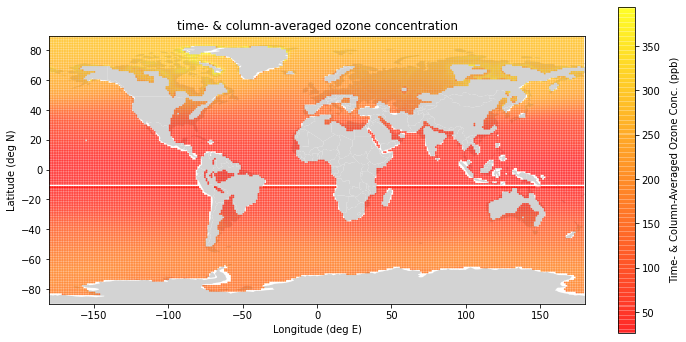

In [207]:
worldmap = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
fig, ax = plt.subplots(figsize=(12, 6))
worldmap.plot(color="lightgrey", ax=ax)

plt.scatter(
    lon_bc, lat_bc, s=0.9, c=col_o3_time_avg.flatten(), alpha=0.6, cmap='autumn'
)
cb = plt.colorbar()
cb.set_label("Time- & Column-Averaged Ozone Conc. (ppb)", labelpad=9)
plt.xlim((-180, 180))
plt.ylim((-90, 90))
plt.xlabel("Longitude (deg E)")
plt.ylabel("Latitude (deg N)")
plt.title("time- & column-averaged ozone concentration")
# plt.savefig("time_and_col_avg_o3_worldmap.png")

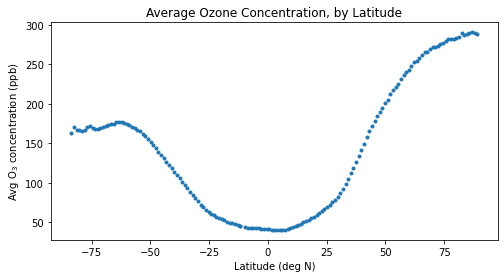

In [208]:
## average over longitude

col_o3_time_avg_weights = np.ones_like(col_o3_time_avg)

for j in range(col_o3_time_avg.shape[0]):
    for k in range(col_o3_time_avg.shape[1]):
        if np.isnan(col_o3_time_avg[j, k]):
            col_o3_time_avg_weights[j, k] = 0
            col_o3_time_avg[j, k] = 0

for j in range(col_o3_time_avg.shape[0]):
    if np.all(col_o3_time_avg_weights[j, :] == 0):
        col_o3_time_avg_weights[j, :] = -1
        col_o3_time_avg[j, :] = np.nan

# print(np.unique(col_o3_time_avg))

col_o3_by_lat = np.average(col_o3_time_avg, axis=-1, weights=col_o3_time_avg_weights)

## set data availability threshold for a valid average
thres = 0.75
for j in range(col_o3_time_avg.shape[0]):
    nan_count = np.count_nonzero(np.isnan(col_o3_time_avg[j, :]))
    if nan_count > thres * col_o3_time_avg.shape[0]:
        col_o3_by_lat[j] = np.nan

# print(np.count_nonzero(~np.isnan(col_o3_by_lat)))

plt.figure(figsize=(8, 4))
plt.plot(lat, col_o3_by_lat, '.')
plt.xlabel("Latitude (deg N)")
plt.ylabel("Avg O$_3$ concentration (ppb)")
plt.title("Average Ozone Concentration, by Latitude")
# plt.savefig("avg_o3_by_latitude.png")

## Interpolate to Produce Even Spacing

- as seen in plot below, changes are not drastic; thus interpolation error is relatively small
- this will allow for easier manipulation of data

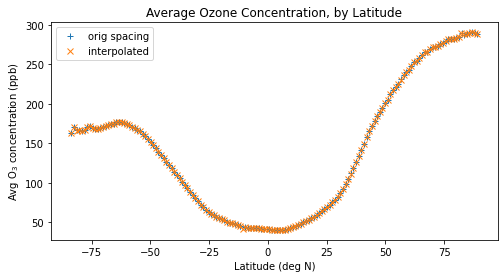

In [209]:
lat_range = max(lat[5:]) - min(lat[5:])
# print(min(lat[5:]), "  ", max(lat[5:]), "  ", lat_range)
cs_interp = CubicSpline(lat[5:], col_o3_by_lat[5:])  # slice off NaNs
lat_grid_count = round(lat_range / np.average(np.diff(lat))) + 1  # endpoint inclusive
lat_grid = np.linspace(min(lat[5:]), max(lat[5:]), lat_grid_count)
col_o3_by_lat_grid = cs_interp(lat_grid)

plt.figure(figsize=(8, 4))
plt.plot(lat, col_o3_by_lat, '+', label="orig spacing")
plt.plot(lat_grid, col_o3_by_lat_grid, 'x', label="interpolated")
plt.xlabel("Latitude (deg N)")
plt.ylabel("Avg O$_3$ concentration (ppb)")
plt.title("Average Ozone Concentration, by Latitude")
plt.legend()
# plt.savefig("interp_avg_o3_by_lat.png")

## Take Fourier Transform (Latitudinal O$_3$)

- filtered out higher frequencies - resulting curve is smoother towards the poles
- away from the poles there aren't really any frequency outliers
- may be more interesting looking at temporal change (e.g. in the Arctic) as opposed to latitudinal (this is done next!)

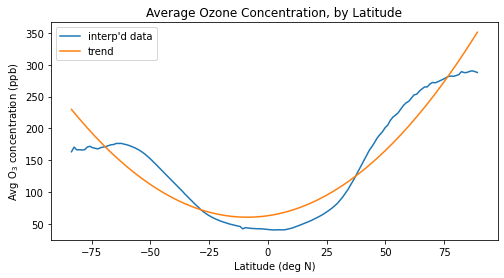

In [210]:
## detrend data

o3_lat_trend_coeffs = np.polyfit(lat_grid, col_o3_by_lat_grid, 2)
o3_lat_trend = (
      o3_lat_trend_coeffs[0] * lat_grid ** 2
    + o3_lat_trend_coeffs[1] * lat_grid
    + o3_lat_trend_coeffs[2]
)

plt.figure(figsize=(8, 4))
plt.plot(lat_grid, col_o3_by_lat_grid, label="interp'd data")
plt.plot(lat_grid, o3_lat_trend, label="trend")
plt.xlabel("Latitude (deg N)")
plt.ylabel("Avg O$_3$ concentration (ppb)")
plt.title("Average Ozone Concentration, by Latitude")
plt.legend()
# plt.savefig("detrend_avg_o3_by_lat.png")

o3_lat_detrend = col_o3_by_lat_grid - o3_lat_trend

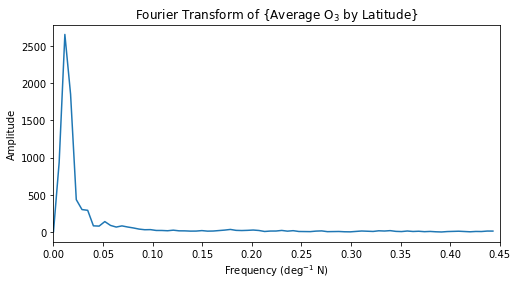

In [211]:
## take FFT

delta_lat = lat_grid[1] - lat_grid[0]
o3_lat_ft = np.fft.fftshift(np.fft.fft(o3_lat_detrend)) * delta_lat
o3_lat_freq = np.fft.fftshift(np.fft.fftfreq(len(lat_grid), delta_lat))

plt.figure(figsize=(8, 4))
plt.plot(o3_lat_freq, np.abs(o3_lat_ft))
plt.xlim(0, 0.45)
plt.xlabel("Frequency (deg$^{-1}$ N)")
plt.ylabel("Amplitude")
plt.title("Fourier Transform of {Average O$_3$ by Latitude}")
# plt.savefig("FT_avg_o3_by_lat.png")

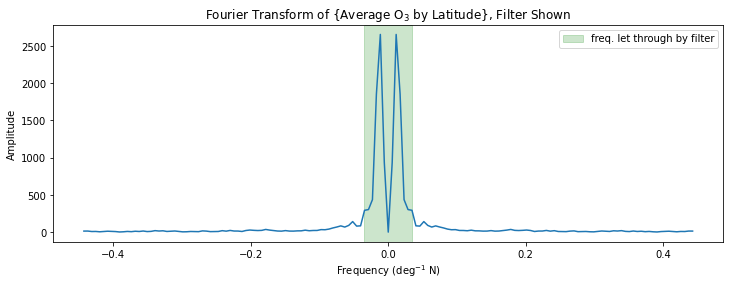

In [212]:
## apply filter

filter_thres_lat = 0.035

fig, ax = plt.subplots(figsize=(12, 4))
plt.plot(o3_lat_freq, np.abs(o3_lat_ft))
ax.axvspan(
    -filter_thres_lat, filter_thres_lat,
    alpha=0.2, color="green", label="freq. let through by filter"
)
plt.xlabel("Frequency (deg$^{-1}$ N)")
plt.ylabel("Amplitude")
plt.title("Fourier Transform of {Average O$_3$ by Latitude}, Filter Shown")
plt.legend()
# plt.savefig("filter_freq_avg_o3_by_lat.png")

filt_start_ind_lat = 0
while o3_lat_freq[filt_start_ind_lat] < -filter_thres_lat:
    filt_start_ind_lat += 1
filt_end_ind_lat = filt_start_ind_lat
while o3_lat_freq[filt_end_ind_lat] < filter_thres_lat:
    filt_end_ind_lat += 1

o3_lat_ft_filt = o3_lat_ft.copy()
o3_lat_ft_filt[:filt_start_ind_lat] = 0
o3_lat_ft_filt[filt_end_ind_lat:] = 0

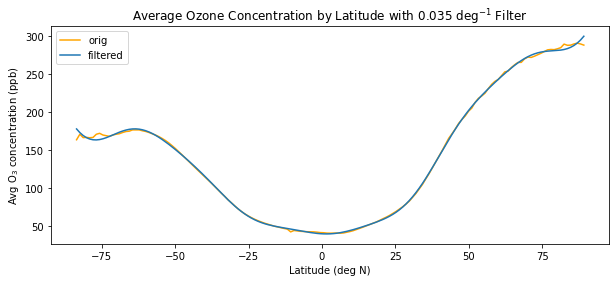

In [213]:
## apply IFFT, add back trend

o3_lat_filt = np.abs(
    np.fft.ifft(
        np.fft.ifftshift(
            o3_lat_ft_filt
        ) / delta_lat
    ) + o3_lat_trend
)

plt.figure(figsize=(10, 4))
plt.plot(lat_grid, col_o3_by_lat_grid, label="orig", color="orange")
plt.plot(lat_grid, o3_lat_filt, label="filtered", color="tab:blue")
plt.xlabel("Latitude (deg N)")
plt.ylabel("Avg O$_3$ concentration (ppb)")
plt.title(
    "Average Ozone Concentration by Latitude with "
    + str(filter_thres_lat) + " deg$^{-1}$ Filter"
)
plt.legend()
# plt.savefig("filtered_avg_o3_by_lat.png")

# Polar O$_3$ Time Series

In [214]:
lat_ind = -1
while lat_grid[lat_ind] > 70:
    lat_ind -= 1
col_o3_north = column_o3[:, lat_ind:, :]

# print(col_o3_north.flatten().size)
# print(np.count_nonzero(np.isnan(col_o3_north)))

## avg over lon
o3_north_lon_avg_weights = np.ones_like(col_o3_north)
for i in range(col_o3_north.shape[0]):
    for j in range(col_o3_north.shape[1]):
        for k in range(col_o3_north.shape[2]):
            if col_o3_north[i, j, k] < 0:
                o3_north_lon_avg_weights[i, j, k] = 0
            if np.isnan(col_o3_north[i, j, k]):
                o3_north_lon_avg_weights[i, j, k] = 0
                col_o3_north[i, j, k] = 0
for i in range(col_o3_north.shape[0]):
    for j in range(col_o3_north.shape[1]):
        if np.all(col_o3_weights[i, j, :] == 0):
            col_o3_weights[i, j, :] = -1
            col_o3_north[i, j, :] = np.nan
o3_north_lon_avg = np.average(
    col_o3_north, axis=2, weights=o3_north_lon_avg_weights
)

## avg over lat
o3_north_weights = np.ones_like(o3_north_lon_avg)
for i in range(o3_north_lon_avg.shape[0]):
    for j in range(o3_north_lon_avg.shape[1]):
        if np.isnan(o3_north_lon_avg[i, j]):
            o3_north_weights[i, j] = 0
            o3_north_lon_avg[i, j] = 0
for i in range(o3_north_lon_avg.shape[0]):
    if np.all(o3_north_weights[i, :] == 0):
        o3_north_weights[i, :] = -1
        o3_north_lon_avg[i, :] = np.nan
o3_north = np.average(
    o3_north_lon_avg, axis=1, weights=o3_north_weights
)

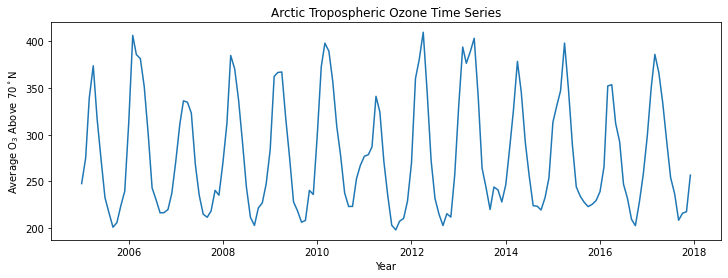

In [215]:
plt.figure(figsize=(12, 4))
plt.plot(time_dt, o3_north)
plt.xlabel("Year")
plt.ylabel("Average O$_3$ Above 70$^\\circ$N")
plt.title("Arctic Tropospheric Ozone Time Series")
# plt.savefig("north_pole_o3_by_time.png")

# Take Fourier Transform (Arctic O$_3$)

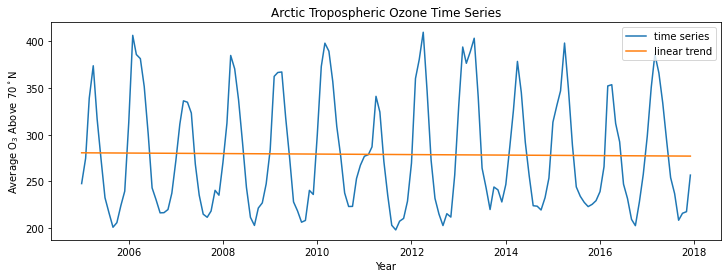

In [216]:
## detrend

o3_north_trend_coeffs = np.polyfit(time, o3_north, 1)
o3_north_trend = o3_north_trend_coeffs[0] * time + o3_north_trend_coeffs[1]

plt.figure(figsize=(12, 4))
plt.plot(time_dt, o3_north, label="time series")
plt.plot(time_dt, o3_north_trend, label="linear trend")
plt.xlabel("Year")
plt.ylabel("Average O$_3$ Above 70$^\\circ$N")
plt.title("Arctic Tropospheric Ozone Time Series")
plt.legend()
# plt.savefig("detrend_north_pole_o3_by_time.png")

o3_north_detrend = o3_north - o3_north_trend

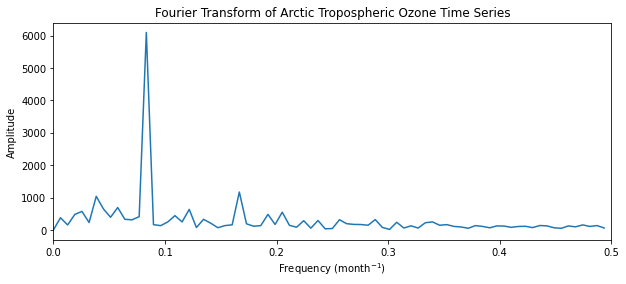

In [217]:
## take FFT

o3_north_ft = np.fft.fftshift(np.fft.fft(o3_north_detrend)) * 1
o3_north_freq = np.fft.fftshift(np.fft.fftfreq(len(o3_north_detrend), 1))

plt.figure(figsize=(10, 4))
plt.plot(o3_north_freq, np.abs(o3_north_ft))
plt.xlim(0, 0.5)
plt.xlabel("Frequency (month$^{-1}$)")
plt.ylabel("Amplitude")
plt.title("Fourier Transform of Arctic Tropospheric Ozone Time Series")
# plt.savefig("FT_north_pole_o3_by_time.png")

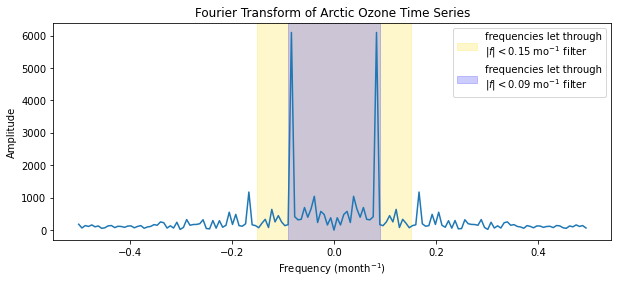

In [218]:
## filter out high frequencies

def ft_filter(
    ft_freq, ft_ampl, filt_thres,
    x_units="units", x_label="", y_label="", title="", colour="green"
):
    filt_start_ind = 0
    while ft_freq[filt_start_ind] < -filt_thres:
        filt_start_ind += 1
    filt_end_ind = filt_start_ind
    while ft_freq[filt_end_ind] < filt_thres:
        filt_end_ind += 1

    ft_ampl_filt = ft_ampl.copy()
    ft_ampl_filt[:filt_start_ind] = 0
    ft_ampl_filt[filt_end_ind:] = 0

    # fig, ax = plt.subplots(figsize=(12, 5))
    # plt.plot(ft_freq, np.abs(ft_ampl))
    ax.axvspan(
        -filt_thres, filt_thres,
        alpha=0.2,
        color=colour,
        label=(
            "frequencies let through\n$|f|<"
            + str(filt_thres) + "$ " + x_units + "$^{-1}$ filter"
        )
    )
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.legend()
    
    return ft_ampl_filt


filter_thresholds = [0.15, 0.09]

fig, ax = plt.subplots(figsize=(10, 4))
plt.plot(o3_north_freq, np.abs(o3_north_ft))
colours = ["gold", "blue"]

o3_north_filts = []
for i in range(len(filter_thresholds)):
    o3_north_filt = ft_filter(
        o3_north_freq, o3_north_ft, filter_thresholds[i],
        x_units="mo",
        x_label="Frequency (month$^{-1}$)",
        y_label="Amplitude",
        title="Fourier Transform of Arctic Ozone Time Series",
        colour=colours[i]
    )
    o3_north_filts.append(o3_north_filt)

# plt.savefig("filter_freq_north_pole_o3_by_time.png")

### Frequency Domain Observations

- clear peak at around $1/12 \approx 0.083 \text{ mo}^{-1}$ which corresponds to an oscillation period of $12 \text{ mo}$ or $1 \text{ yr}$
- seasonal variability!

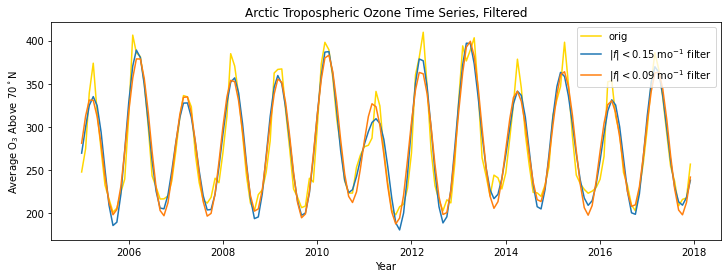

In [219]:
## take IFFT, add back trend

def filter_ifft(
    ft_ampl_filt, delta_x, trend, x_data_orig, filt_thres,
    x_units="units", x_label="", y_label="", title=""
):
    y_data_filt = np.abs(
        np.fft.ifft(
            np.fft.ifftshift(
                ft_ampl_filt
            ) / delta_x
        ) + trend
    )

    plt.plot(
        x_data_orig, y_data_filt,
        label="$|f|<" + str(filt_thres) + "$ " + x_units + "$^{-1}$ filter"
    )
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.legend()

    return y_data_filt

plt.figure(figsize=(12, 4))
plt.plot(time_dt, o3_north, label="orig", color="gold")

for i in range(len(filter_thresholds)):
    o3_north_filt = filter_ifft(
        o3_north_filts[i], 1, o3_north_trend,
        time_dt, filter_thresholds[i],
        x_units="mo",
        x_label="Year",
        y_label="Average O$_3$ Above 70$^\\circ$N",
        title="Arctic Tropospheric Ozone Time Series, Filtered"
    )

# plt.savefig("filtered_north_pole_o3_by_time.png")

# Autocorrelation of Arctic Time Series

- using FFT method (could also use convolution method, which is fewer lines of code but slower)
- tested: zero-padding has little effect on the autocorrelation function (resulting autocorrelation function is near-identical in domain of interest)

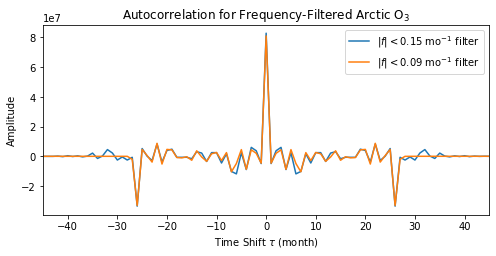

In [220]:
plt.figure(figsize=(8, 3.5))
plt.xlim(-45, 45)
plt.xlabel("Time Shift $\\tau$ (month)")
plt.ylabel("Amplitude")
plt.title("Autocorrelation for Frequency-Filtered Arctic O$_3$")

for i in range(len(o3_north_filts)):
    cross_corr_ft = (
        np.conjugate(np.fft.fft(o3_north_filts[i]) * 1)
        * np.fft.fft(o3_north_filts[i])
        * 1
    )
    cross_corr = np.fft.fftshift(np.fft.ifft(cross_corr_ft) / 1)
    tau = np.linspace(
        -len(o3_north_filts[i]) / 2,
        len(o3_north_filts[i]) / 2,
        len(cross_corr),
        endpoint=False,
    )

    plt.plot(
        tau, cross_corr.real,
        label="$|f|<" + str(filter_thresholds[i]) + "$ mo$^{-1}$ filter"
    )
plt.legend()
# plt.savefig("autocorr_filtered_north_pole_o3_by_time.png")

# References

https://tes.jpl.nasa.gov/tes/chemical-reanalysis (courtesy of Prof Jones)

https://acp.copernicus.org/articles/15/8315/2015/acp-15-8315-2015.pdf

# Additional Things to Explore

* altitude/pressure level trends
* applying windowing functions (convolutions!)